<a href="https://colab.research.google.com/github/valentina-s/stand_mapping/blob/master/notebooks/0X_Sandbox/valentina_discriminative_loss_training_stand_mapping_validation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

This is a modificaiton of Unet Segmentation with Discriminative Loss:

https://github.com/nyoki-mtl/pytorch-discriminative-loss

[Semantic Instance Segmentation with a Discriminative Loss Function](https://arxiv.org/abs/1708.02551)

In this version we have set the discriminative cost to zero, and removed all instance references. It requires the branch `stand-mapping` from https://github.com/valentina-s/pytorch-discriminative-loss.

### Experiment 1

Vanilla U-net:

4 inputs: NAIP

5 targets: 1=water, 2=forest, 3=field, 4=barren, 5=developed

In [286]:
import numpy as np
import os
import glob

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset, SubsetRandomSampler
from torch.autograd import Variable
from torchvision import transforms
from tqdm.notebook import tqdm

In [287]:
import matplotlib.pyplot as plt

In [288]:
import pandas as pd

In [289]:
import torchvision

In [290]:
# Resource Performance Monitor
from urllib.request import urlopen
exec(urlopen("http://colab-monitor.smankusors.com/track.py").read())
_colabMonitor = ColabMonitor().start()

Now live at : http://colab-monitor.smankusors.com/60485c350d02a


In [291]:
# Load the TensorBoard notebook extension
%reload_ext tensorboard

In [292]:
from torch.utils.tensorboard import SummaryWriter

In [293]:
# Writer will output to ./runs/ directory by default
writer = SummaryWriter(log_dir='runs/')

In [294]:
# setting the devicide to cuda if available
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

Before running download the model from [model.pth](https://drive.google.com/drive/folders/1ihcqYr9PptELUZjHVL7jT4LXB3VpfxNt), and put it under `pytorch-discriminative-loss/model/`

In [295]:
import sys
sys.path.remove('/gdrive/stand_mapping')
sys.path.remove('/gdrive/stand_mapping/stand_mapping')

ValueError: list.remove(x): x not in list

In [296]:
sys.path

['/home/d-diaz/anaconda3/envs/stand_mapping/lib/python36.zip',
 '/home/d-diaz/anaconda3/envs/stand_mapping/lib/python3.6',
 '/home/d-diaz/anaconda3/envs/stand_mapping/lib/python3.6/lib-dynload',
 '',
 '/home/d-diaz/anaconda3/envs/stand_mapping/lib/python3.6/site-packages',
 '/home/d-diaz/anaconda3/envs/stand_mapping/lib/python3.6/site-packages/IPython/extensions',
 '/home/d-diaz/.ipython',
 '/home/d-diaz/stand_mapping_valentina_fork/stand_mapping/',
 '/home/d-diaz/stand_mapping_valentina_fork/stand_mapping/',
 '/home/d-diaz/stand_mapping_valentina_fork/stand_mapping/']

In [297]:
# import sys
# sys.path.append('../../stand_mapping/')

In [298]:
import sys
# sys.path.append('../../stand_mapping/')
sys.path.append('/home/d-diaz/stand_mapping_valentina_fork/stand_mapping/')

In [299]:
sys.path

['/home/d-diaz/anaconda3/envs/stand_mapping/lib/python36.zip',
 '/home/d-diaz/anaconda3/envs/stand_mapping/lib/python3.6',
 '/home/d-diaz/anaconda3/envs/stand_mapping/lib/python3.6/lib-dynload',
 '',
 '/home/d-diaz/anaconda3/envs/stand_mapping/lib/python3.6/site-packages',
 '/home/d-diaz/anaconda3/envs/stand_mapping/lib/python3.6/site-packages/IPython/extensions',
 '/home/d-diaz/.ipython',
 '/home/d-diaz/stand_mapping_valentina_fork/stand_mapping/',
 '/home/d-diaz/stand_mapping_valentina_fork/stand_mapping/',
 '/home/d-diaz/stand_mapping_valentina_fork/stand_mapping/',
 '/home/d-diaz/stand_mapping_valentina_fork/stand_mapping/']

In [300]:
ls

TensorBoardTest.ipynb
models/
runs/
runs_test/
valentina_discriminative_loss_training_stand_mapping_validation.ipynb


In [301]:
from models.unet import UNet
from utils.criterion import DiscriminativeLoss

In [302]:
# set the number of input and output classes
N_CHANNELS = 4
N_CLASSES = 6

In [303]:
# Initialize the model (set number of input and output channels)
model = UNet(in_ch=N_CHANNELS, out_ch=N_CLASSES).to(device)

In [304]:
# load drive
#from google.colab import drive
#drive.mount('/content/drive', force_remount=True)

In [305]:
ROOT_DIR = '/gdrive/stand_mapping/data/processed/training_tiles/'

In [306]:
from data.dataset import SemanticDataset
# from stand_mapping.data.dataset import SemanticDataset

In [307]:
input_transformer = transforms.Compose([
    transforms.Resize((256,256), interpolation=2), # bilinear interpolation to 256x256
    # transforms.Normalize(naip_rgb_mean, naip_rgb_std),
    # transforms.Normalize(naip_chip_mean, naip_chip_std),
])

target_transformer = transforms.Compose([
    transforms.Resize((256,256), interpolation=0), # nearest neighbor interpolation to 256x256
])

In [315]:
df = pd.read_csv('/gdrive/stand_mapping/data/processed/training_tiles/tileindex.csv')
# using only 90% of the all data (that will be further split for training and validation)
print(len(df))
df = df.sample(int(0.9*len(df))).reset_index()
ds = SemanticDataset(root='/gdrive/stand_mapping/data/processed', 
                     dataframe=df, raw_chip_size=256, use_layers={'naip': True},
                     transform=target_transformer, target_transform=target_transformer,
                     random_seed=1) 
print(len(ds))

2020
1818


In [244]:
naip_chip_mean = [74.77060828, 92.60867138, 81.82211117, 122.17832602]  # R, G, B, NIR
naip_chip_std = [31.83725084, 30.74003338, 16.31047271, 43.92487841]  # R, G, B, NIR
naip_rgb_mean = [74.77060828, 92.60867138, 81.82211117]
naip_rgb_std = [31.83725084, 30.74003338, 16.31047271]

In [316]:
# here we create train and validation dataloaders (borth working on the same dataset)

In [317]:
# create indeces to split train_dataset further to train and validation sets
def train_val_split_sampler(dataset, train_val_ratio):
    """
        Returns samplers which can split the dataset into train and validation in the data loaders
        
        Input
        
        train_val_ratio: the ration of the train and validation set size
        dataset: dataset for which indeces will be generated
        
        Output
        train_sampler
        val_sampler
        
    
    """
    dataset_size = len(dataset)
    indices = list(range(dataset_size))
    split = int(np.floor(train_val_ratio * dataset_size))
    train_indices, val_indices = indices[:split], indices[split:]
    train_sampler = SubsetRandomSampler(train_indices)
    val_sampler = SubsetRandomSampler(val_indices)
    
    return(train_sampler, val_sampler)
    


In [318]:
RATIO=0.8

In [319]:
train_sampler, val_sampler = train_val_split_sampler(ds, RATIO)

In [320]:
# train dataloader
train_dataloader = DataLoader(ds, batch_size=10,
                        num_workers=2, pin_memory=True,
                        sampler=train_sampler)


In [321]:
# validation dataloader
val_dataloader = DataLoader(ds, batch_size=10,
                        num_workers=2, pin_memory=True, 
                        sampler=val_sampler)

In [251]:
from visualization.visualize import colorize_landcover 

In [323]:
# auxiliary functions: need to move them to source

def recolor_landcover(lc_img, cmap, soft=False, num_classes=4):
  cover_colors = np.zeros((lc_img.shape[0], lc_img.shape[1], 3))
  if not soft:
      for cov in np.unique(lc_img):
          mask = lc_img == cov
          cover_colors[mask] = cmap[cov]
  if soft: # we're given the probability of each class for each pixel
      for i in range(num_classes - 1):
          cover_colors[:,:,0] += lc_img[:,:,i] * cmap[i+1][0] # R
          cover_colors[:,:,1] += lc_img[:,:,i] * cmap[i+1][1] # G
          cover_colors[:,:,2] += lc_img[:,:,i] * cmap[i+1][2] # B

  return (cover_colors * 255).astype(np.uint8)

def recolor_landcover_batch(image_batch, cmap, soft=False, num_classes=4):
  """ recolor_landcover_batch applies the recolor_landcover function to a batch of images;
  the expectation is that the image_batch is of size batch_size, # channels, H,W
  """
  colored_image_batch = [torch.from_numpy(recolor_landcover(image_batch[i], cmap, soft=soft, num_classes = num_classes )) for i in range(image_batch.shape[0])]
  colored_image_stack = torch.stack(colored_image_batch, axis=0)
  
  return(colored_image_stack)

def colorize_landcover_batch(image_batch, soft=False):
  """ recolor_landcover_batch applies the recolor_landcover function to a batch of images;
  the expectation is that the image_batch is of size batch_size, # channels, H,W
  """
  colored_image_batch = [torch.from_numpy(colorize_landcover(image_batch[i], soft=soft)) for i in range(image_batch.shape[0])]
  colored_image_stack = torch.stack(colored_image_batch, axis=0)
  
  return(colored_image_stack)

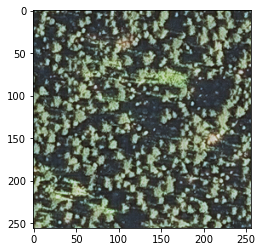

In [324]:
plt.imshow(np.moveaxis(ds[5][0].numpy()[0:3,:,:], 0,-1).astype(np.uint8))

In [256]:
from rasterio.plot import reshape_as_image

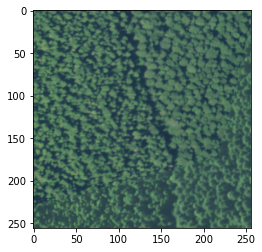

In [257]:
plt.imshow(reshape_as_image(ds[5][0][:3,:,:].numpy()).astype('int'))

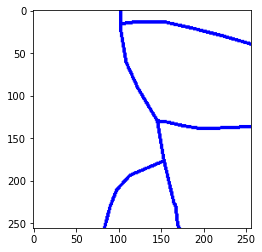

In [258]:
cover = colorize_landcover(ds[5][1].squeeze())
plt.imshow(cover)

57
66
26
75
73
178
140
44
54
143


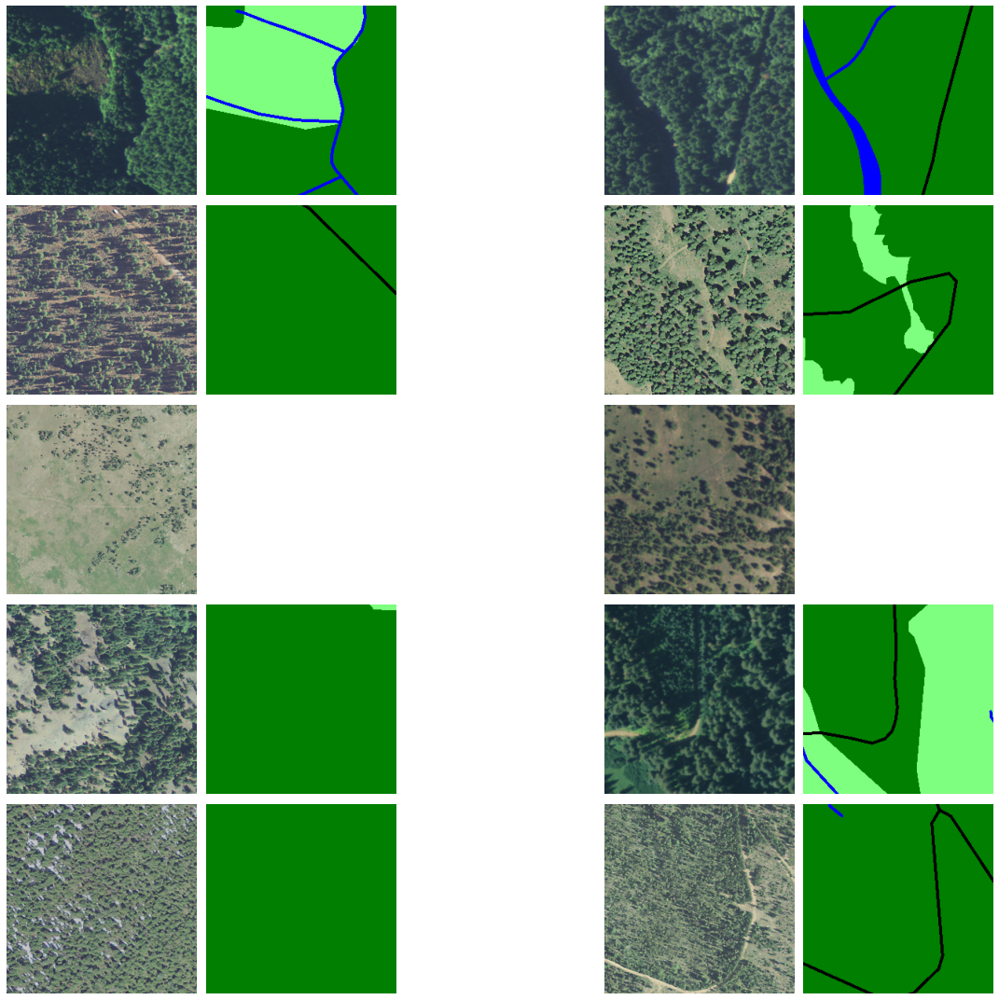

In [264]:
NUM_CHIPS = 10
fig, axs = plt.subplots(nrows=NUM_CHIPS//2, ncols=5, figsize=(5*3, 3*NUM_CHIPS//2))
for i in range(NUM_CHIPS):
  np.random.seed()
  chip_num = np.random.randint(0, len(ds))
  row_num = i//2
  j = 0 if i % 2 == 0 else 3
  print(chip_num)
  tile = ds[chip_num]
  axs[row_num, j].imshow(np.moveaxis(tile[0].numpy()[0:3,:,:], 0,-1).astype(np.uint8))
  cover = (tile[1]).numpy().squeeze().astype(np.uint8)
  nodata = (tile[2]).numpy().squeeze()
  cover[nodata] = 0
  cover_color = colorize_landcover(cover)
  axs[row_num, j+1].imshow(cover_color)
  # axs[row_num, j+1].imshow(ds[chip_num][2].numpy().squeeze())

for ax in axs.ravel():
    ax.axis('off')

plt.tight_layout()
plt.show()

In [265]:
# Loss Function
criterion_ce = nn.CrossEntropyLoss(reduction='none').to(device)

In [266]:
# Optimizer
parameters = model.parameters()
optimizer = optim.SGD(parameters, lr=0.01, momentum=0.9, weight_decay=0.001)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer=optimizer,
                                                 mode='min',
                                                 factor=0.1,
                                                 patience=10,
                                                 verbose=True)

Run a training loop.

In [169]:
# from stand_mapping.stand_mapping.utils import scoring

In [170]:
#%tensorboard --logdir=/content/runs
#%tensorboard --logdir=runs

In [171]:
# ls ../../stand_mapping/utils

In [172]:
# import sys
# sys.path.append("../../stand_mapping/utils")

In [267]:
from utils.metrics import batchify
from utils.scoring import masks_iou, mask_f1_score, boundary_f1_score

In [285]:
writer = SummaryWriter(comment="SemSeg")

import warnings
#part of the message is also okay
warnings.filterwarnings("ignore", message="Default upsampling behavior") 

# Train
model_dir = ('models')
os.makedirs(model_dir, exist_ok=True)

best_loss = np.inf
NUM_EPOCHS = 5
for epoch in range(NUM_EPOCHS):
    
    ### Training ###
    with tqdm(total=int(np.ceil(RATIO*len(ds) / 10)), # 10 samples per batch
              desc=f'epoch {epoch+1}') as pbar:
        # print(f'epoch : {epoch+1}', end=' ')

        model.train()
        disc_losses = []
        ce_losses = []

        batch_num = 1
        for batched in train_dataloader:
            
            images, sem_labels, nodata = batched

            images = Variable(images).to(device)
            sem_labels = Variable(sem_labels).to(device)
            nodata = Variable(nodata).to(device)

            model.zero_grad()
            sem_predict = model(images)

            # calculate loss within mask
            loss = 0            
            mask = ~nodata
            ce_loss = criterion_ce(sem_predict, sem_labels.squeeze())
            ce_loss = mask*ce_loss
            ce_loss = torch.sum(ce_loss.flatten(start_dim=1), axis=0) # Sums the loss per image
            ce_loss = torch.mean(ce_loss) # loss per batch
            loss += ce_loss
            ce_losses.append(ce_loss.cpu().data.numpy())

            
            
            loss.backward()
            optimizer.step()
            pbar.update()

        ce_loss = np.mean(ce_losses)
        print(f'Train CrossEntropyLoss: {ce_loss:.4f}', end = ' ')
        loss = ce_loss
        
        # save model based on ce_loss (not discriminative)
        if loss < best_loss:
            best_loss = loss
            modelname = 'exp002_model.pth'
            torch.save(model.state_dict(), os.path.join(model_dir, modelname))

        

    ### Validation ###
    with torch.no_grad():
        model.eval()
        val_losses = []
        f1_scores = []
        for batched in val_dataloader:
            
            images, sem_labels, nodata = batched
            images = Variable(images).to(device)
            sem_labels = Variable(sem_labels).to(device)
            nodata = Variable(nodata).to(device)

            model.zero_grad()

            sem_predict = model(images)            
            model.eval()
            
              
            # calculate loss within mask
            mask = ~nodata
            val_loss = criterion_ce(sem_predict, sem_labels.squeeze())
            val_loss = mask*val_loss
            val_loss = torch.sum(val_loss.flatten(start_dim=1), axis=0) # Sums the loss per image
            val_loss = torch.mean(val_loss) # loss per batch
            val_losses.append(val_loss.cpu().data.numpy())

            # calculate iou for a batch
            f1_scores.append(batchify( sem_labels.cpu().squeeze(), sem_predict.argmax(dim=1).cpu().squeeze(), nodata.cpu().squeeze(), mask_f1_score))
            # f1_score_b = batchify(boundary_f1_score(sem_labels.cpu(), sem_predict.cpu(), nodata.cpu()))
              
        val_loss = np.mean(val_losses)
        print(f'Validation CrossEntropyLoss: {val_loss:.4f}', end = ' ')
        
        
        ### Tensorboard Logging ###

        # log losses
        writer.add_scalars("Losses",{'train_loss': loss,'val_loss': val_loss}, epoch)
        writer.flush()
        
        # log metrics
        iou_score, f1_score, precision, recall = f1_scores[-1]
        writer.add_scalars("Metrics",{'iou': iou_score,'f1': f1_score, 'precision': precision, 'recall': recall}, epoch)
        writer.flush()   
    
        # log training images
        # normalized_images = (images.cpu()*torch.tensor(np.array(naip_chip_std).reshape(1,4,1,1))+torch.tensor(np.array(naip_chip_mean).reshape(1,4,1,1)))[:,:3,:,:]
        images = images.cpu()[:,:3,:,:]     
        img_grid = torchvision.utils.make_grid(images, nrow=images.shape[0])
        writer.add_image('Validation Images Batch', img_grid.numpy().astype('uint8'), epoch)
        writer.flush()

        # log predicted images
        pred_recolor = colorize_landcover_batch(sem_predict.argmax(dim=1).cpu()) 
        pred_grid = torchvision.utils.make_grid(pred_recolor.permute(0,3,1,2), nrow=pred_recolor.shape[0])
        writer.add_image('Validation Predictions Batch', pred_grid, epoch)       
        writer.flush()
        
        # log labels
        labels_recolor = colorize_landcover_batch(sem_labels.cpu().squeeze()) 
        labels_grid = torchvision.utils.make_grid(labels_recolor.permute(0,3,1,2), nrow=labels_recolor.shape[0])
        writer.add_image('Validation Labels Batch', labels_grid.numpy().astype('uint8'), epoch)       
        writer.flush()
        
writer.close()


    

epoch 1:   0%|          | 0/16 [00:00<?, ?it/s]

Train CrossEntropyLoss: 5.7198 Validation CrossEntropyLoss: 5.1926 tensor(254.)
torch.Size([3, 260, 2582])
torch.Size([10, 256, 256, 3])
torch.Size([3, 260, 2582])


epoch 2:   0%|          | 0/16 [00:00<?, ?it/s]

Train CrossEntropyLoss: 5.5569 Validation CrossEntropyLoss: 5.0129 tensor(254.)
torch.Size([3, 260, 2582])
torch.Size([10, 256, 256, 3])
torch.Size([3, 260, 2582])


epoch 3:   0%|          | 0/16 [00:00<?, ?it/s]

Train CrossEntropyLoss: 5.5251 Validation CrossEntropyLoss: 4.9272 tensor(253.)
torch.Size([3, 260, 2582])
torch.Size([10, 256, 256, 3])
torch.Size([3, 260, 2582])


epoch 4:   0%|          | 0/16 [00:00<?, ?it/s]

Train CrossEntropyLoss: 5.7455 Validation CrossEntropyLoss: 5.7498 tensor(233.)
torch.Size([3, 260, 2582])
torch.Size([10, 256, 256, 3])
torch.Size([3, 260, 2582])


epoch 5:   0%|          | 0/16 [00:00<?, ?it/s]

Train CrossEntropyLoss: 5.6606 Validation CrossEntropyLoss: 4.9821 tensor(254.)
torch.Size([3, 260, 2582])
torch.Size([10, 256, 256, 3])
torch.Size([3, 260, 2582])


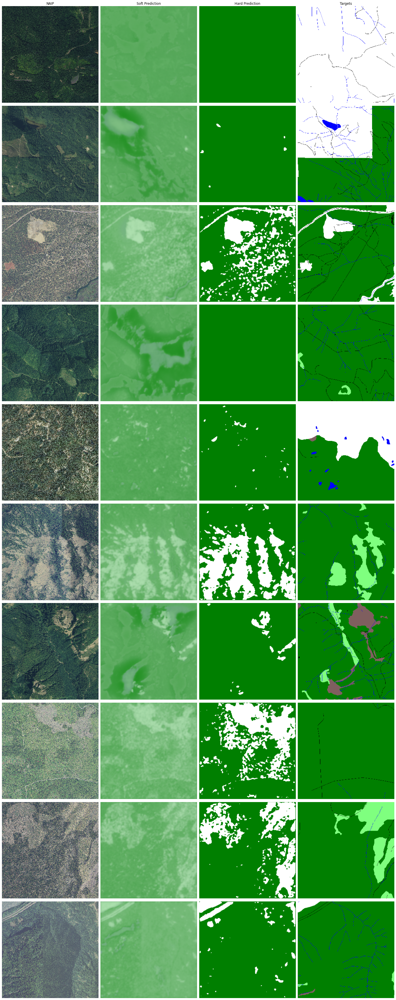

In [177]:
# display results from the last batch
num_chips = images.shape[0]
fig, axs = plt.subplots(NUM_CHIPS, 4, figsize=(20,5*num_chips))
for i in range(num_chips):
    axs[i, 0].imshow(images[i].detach().cpu().permute(1,2,0).numpy().astype(np.uint8)[:,:,0:3])
    pred_proba = F.softmax(sem_predict[i],dim=0).permute(1,2,0).cpu().detach().numpy()
    axs[i, 1].imshow(colorize_landcover(pred_proba, soft=True))
    axs[i, 2].imshow(colorize_landcover(sem_predict[i].argmax(dim=0).cpu().detach().numpy()))
    labels = sem_labels[i][0]
    # labels[nodata[i][0]] = 0
    axs[i, 3].imshow(colorize_landcover(labels.cpu().detach().numpy()))
for ax in axs.ravel():
    ax.axis('off')
axs[0,0].set_title('NAIP')
axs[0,1].set_title('Soft Prediction')
axs[0,2].set_title('Hard Prediction')
axs[0,3].set_title('Targets')

plt.tight_layout()
plt.show()

In [ ]:
ls runs

In [269]:
ls runs/Mar10_00-44-56_incubatorVMSemSeg/

Losses_train_loss/  Metrics_precision/
Losses_val_loss/    Metrics_recall/
Metrics_f1/         events.out.tfevents.1615337096.incubatorVM.55276.2
Metrics_iou/


In [ ]:
# rm -r runs/*

In [ ]:
# %tensorboard --logdir=runs --reload_multifile True
%tensorboard --logdir=runs

In [ ]:
# %tensorboard dev upload --logdir runs


In [328]:
%env NEPTUNE_API_TOKEN='token'

env: NEPTUNE_API_TOKEN='token'


In [326]:
!neptune tensorboard runs/ --project stand-mapping/sandbox

Traceback (most recent call last):
  File "/home/d-diaz/anaconda3/envs/stand_mapping/bin/neptune", line 6, in <module>
    from neptune_cli.main import main
  File "/home/d-diaz/anaconda3/envs/stand_mapping/lib/python3.6/site-packages/neptune_cli/main.py", line 33, in <module>
    main.add_command(entry_point.load(), name)
  File "/home/d-diaz/anaconda3/envs/stand_mapping/lib/python3.6/site-packages/pkg_resources/__init__.py", line 2449, in load
    self.require(*args, **kwargs)
  File "/home/d-diaz/anaconda3/envs/stand_mapping/lib/python3.6/site-packages/pkg_resources/__init__.py", line 2472, in require
    items = working_set.resolve(reqs, env, installer, extras=self.extras)
  File "/home/d-diaz/anaconda3/envs/stand_mapping/lib/python3.6/site-packages/pkg_resources/__init__.py", line 777, in resolve
    raise VersionConflict(dist, req).with_context(dependent_req)
pkg_resources.ContextualVersionConflict: (scipy 1.5.2 (/home/d-diaz/anaconda3/envs/stand_mapping/lib/python3.6/site-packag

In [327]:
!neptune --version

Traceback (most recent call last):
  File "/home/d-diaz/anaconda3/envs/stand_mapping/bin/neptune", line 6, in <module>
    from neptune_cli.main import main
  File "/home/d-diaz/anaconda3/envs/stand_mapping/lib/python3.6/site-packages/neptune_cli/main.py", line 33, in <module>
    main.add_command(entry_point.load(), name)
  File "/home/d-diaz/anaconda3/envs/stand_mapping/lib/python3.6/site-packages/pkg_resources/__init__.py", line 2449, in load
    self.require(*args, **kwargs)
  File "/home/d-diaz/anaconda3/envs/stand_mapping/lib/python3.6/site-packages/pkg_resources/__init__.py", line 2472, in require
    items = working_set.resolve(reqs, env, installer, extras=self.extras)
  File "/home/d-diaz/anaconda3/envs/stand_mapping/lib/python3.6/site-packages/pkg_resources/__init__.py", line 777, in resolve
    raise VersionConflict(dist, req).with_context(dependent_req)
pkg_resources.ContextualVersionConflict: (tensorflow-estimator 2.4.0 (/home/d-diaz/anaconda3/envs/stand_mapping/lib/python